In [1]:
import os
import sys
import numpy as np
import gzip
import IPython.display as ipd
import itertools
import matplotlib.pyplot as plt
import scipy.io.wavfile as wav
import soundfile as sf
import struct

# Allows me to import my modules
sys.path.append('./modules')
from audio_utils import *

Attempting to read settings file...
	Read successfully!


In [2]:
samples = read_data("cropped", batch_index=0, batch_size=100)

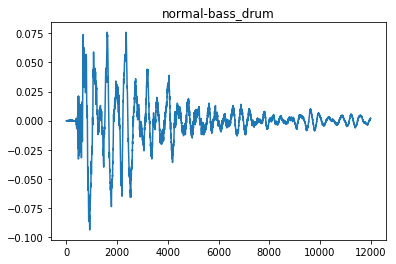

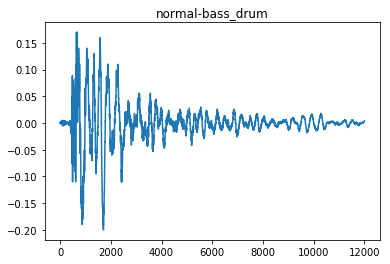

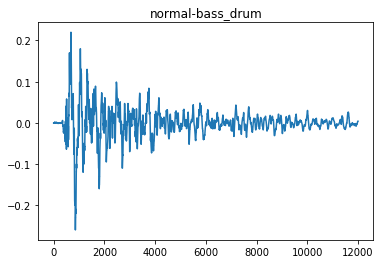

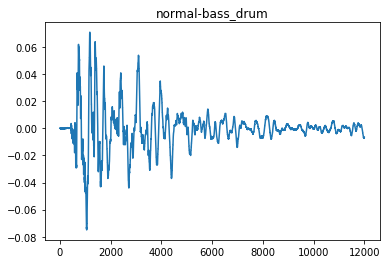

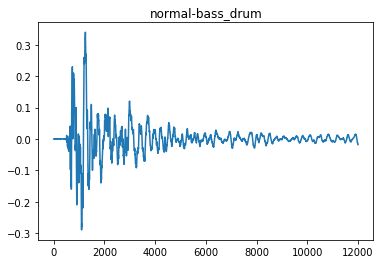

...

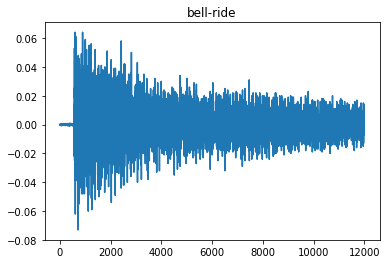

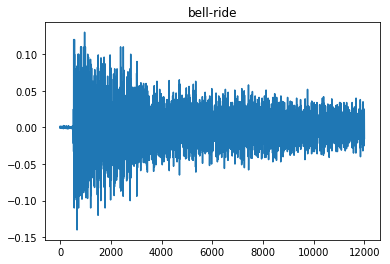

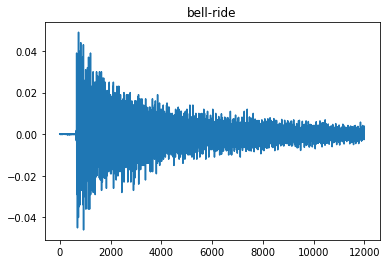

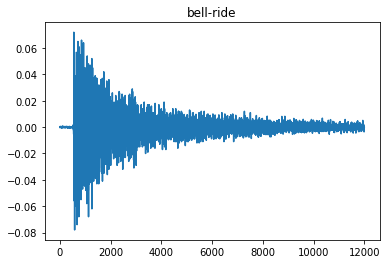

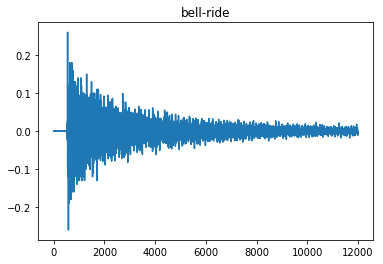

In [4]:
for sample in samples:
    plt.plot(sample.data)
    plt.title("-".join([sample.labels["tech_label"][0], sample.labels["kit_label"][0]]))
    plt.show()

In [7]:
ipd.Audio(samples[-1].data, rate=samples[-1].rate)

In [8]:
ipd.Audio(samples[0].data, rate=samples[0].rate)

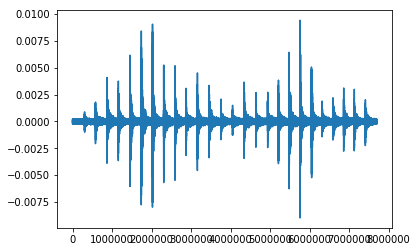

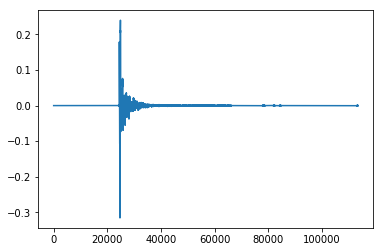

In [9]:
for s in samples:
    plt.plot(s.data)
    plt.show()

In [8]:
cropped_bds = read_data("cropped", batch_size=30, verbose=True, kit_label=["bass_drum"])

Attempting to read30cropped data and labels (from index0)...
	Only{'kit_label': ['bass_drum']}
	Read: 26/26 (26 files found), 26 samples of data.


In [9]:
len(cropped_bds)

26

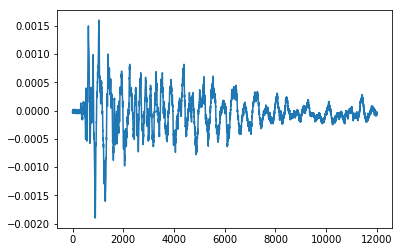

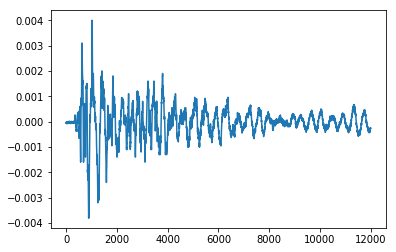

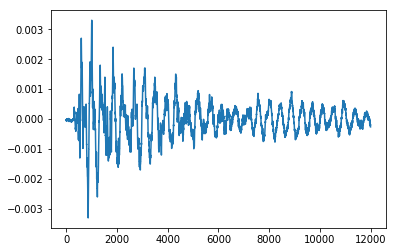

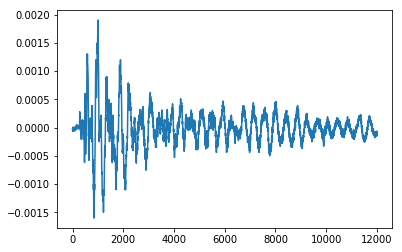

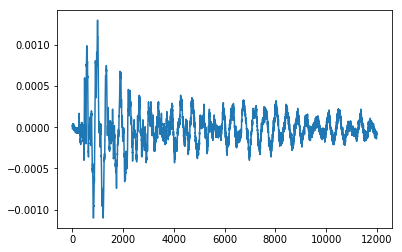

...

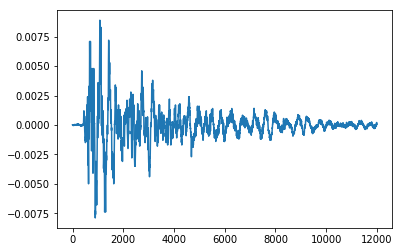

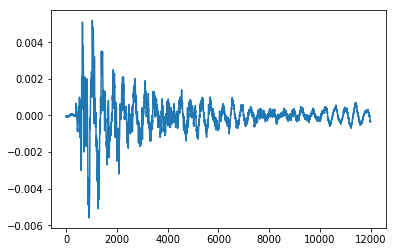

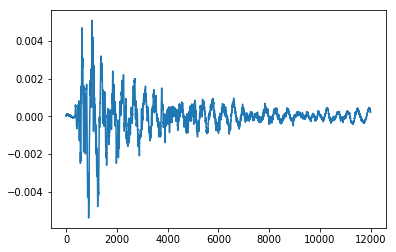

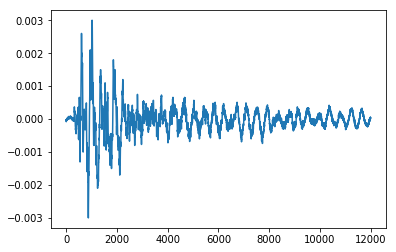

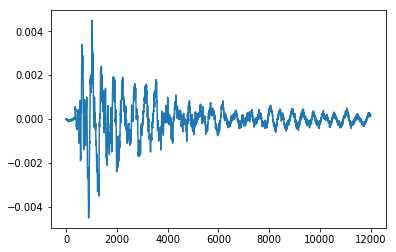

In [10]:
for crop in cropped_bds:
    plt.plot(crop.data)
    plt.show()

In [5]:
ipd.Audio(cropped_bds[0].data, rate=cropped_bds[-9].rate)

In [21]:
ipd.Audio(cropped_bds[-12].data, rate=cropped_bds[-12].rate)

In [17]:
AUGS = {"amplitude": 1, "pitch": 2, "translate": 3}
orderedAugKeys = list(AUGS.keys())
orderedAugKeys.sort()

aug_stacks = [[a] for a in orderedAugKeys]
for i in range(2, len(orderedAugKeys)):
    aug_stacks.extend([[*a] for a in itertools.combinations(orderedAugKeys, i)])
aug_stacks.append(orderedAugKeys)
aug_stacks

[['amplitude'],
 ['pitch'],
 ['translate'],
 ['amplitude', 'pitch'],
 ['amplitude', 'translate'],
 ['pitch', 'translate'],
 ['amplitude', 'pitch', 'translate']]

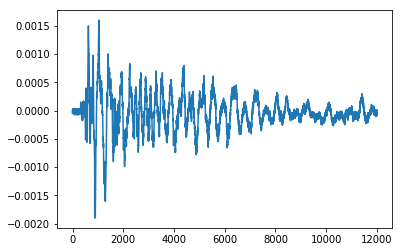

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'post_augs': ['add_noise']}


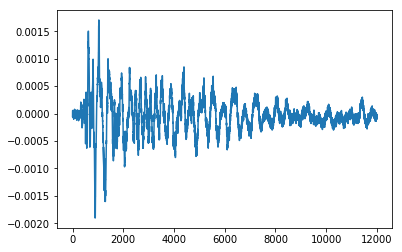

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'post_augs': ['add_noise']}


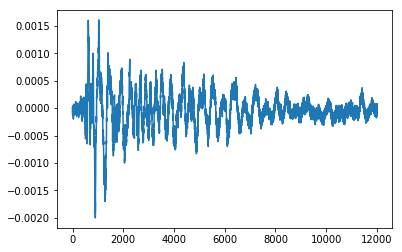

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'post_augs': ['add_noise']}


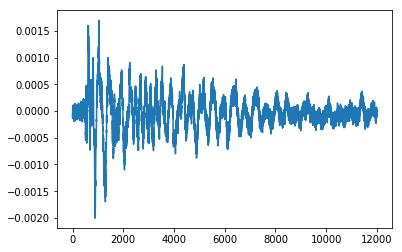

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'post_augs': ['add_noise']}


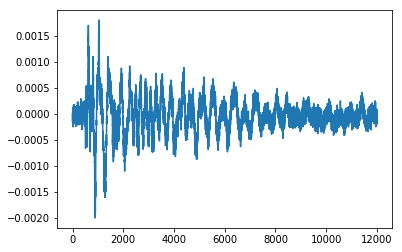

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'post_augs': ['add_noise']}


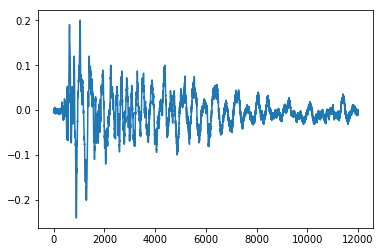

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


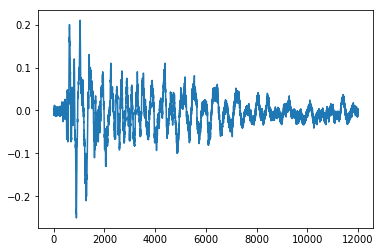

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


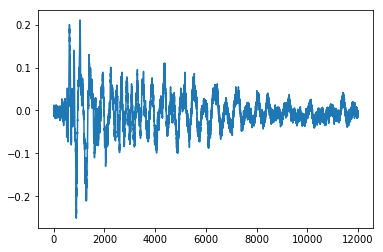

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


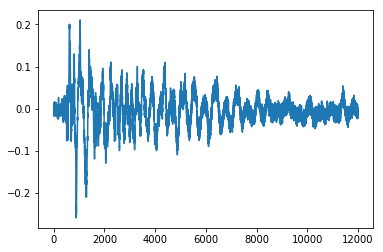

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


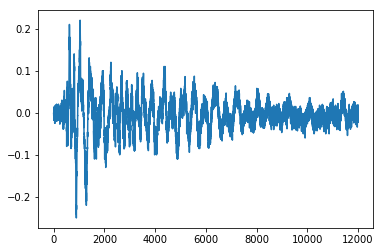

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


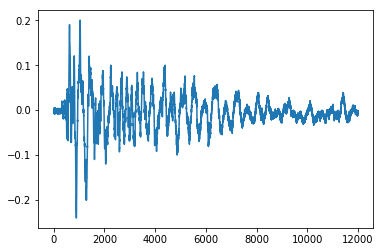

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


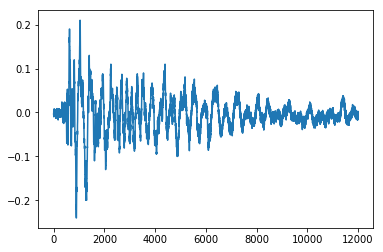

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


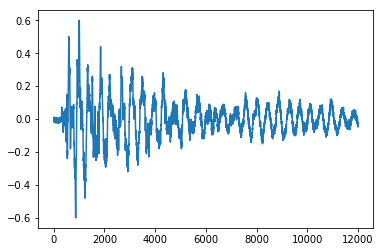

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


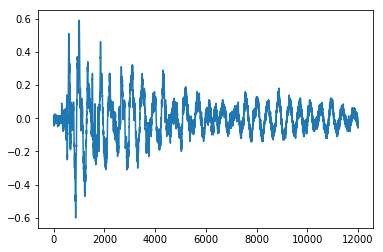

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


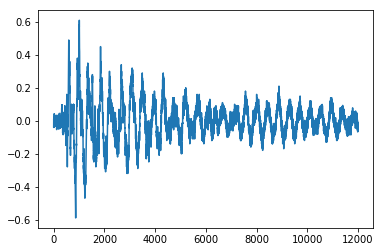

Labels: {'tech_label': ['normal'], 'hit_label': ['beater'], 'kit_label': ['bass_drum']}

Augmentations: {'pre_augs': ['amplitude'], 'post_augs': ['add_noise']}


In [3]:
pm_anps = read_data("post_multiclass_augmented_no_pre", batch_index=0, batch_size=5)
pm_apps = read_data("post_multiclass_augmented_per_pre", batch_index=0, batch_size=5)
pm_as = read_data("post_multiclass_augmented", batch_index=0, batch_size=5)

for samples in [*pm_anps, *pm_apps, *pm_as]:
    plt.plot(samples.data)
    plt.show()
    print("Labels: {}\n\nAugmentations: {}".format(samples.labels, samples.augmentations))

In [5]:
pm_anps[0].data.shape

(12000,)